In [ ]:
🔗 Full project repository:
https://github.com/seu-usuario/pneumonia-xray-bias-mitigation


In [23]:
import os

print("🔧 Configurando Ambiente de Deep Learning...")
print("1. Ajustando versões incompatíveis (Numpy 1.x, Protobuf, Scikit-Learn)...")

# COMANDO ÚNICO E ROBUSTO
# Resolve:
# - Numpy 2.x quebra o TensorFlow (forçamos <2.0)
# - Protobuf novo quebra o salvamento do Keras (forçamos 3.20.3)
# - Scikit-Learn novo quebra o UMAP (forçamos 1.5.2)
!pip install "numpy<2.0" "protobuf==3.20.3" "scikit-learn==1.5.2" umap-learn matplotlib seaborn --force-reinstall --quiet

# 2. Configuração de Logs
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

print("✅ Ambiente Configurado com Sucesso!")
print("⚠️ IMPORTANTE: O Python ainda está usando as versões velhas na memória RAM.")
print("➡️ Vá em 'Run' > 'Restart Session' AGORA para aplicar as mudanças.")

🔧 Configurando Ambiente de Deep Learning...
1. Ajustando versões incompatíveis (Numpy 1.x, Protobuf, Scikit-Learn)...
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 2.12.0 requires google-cloud-bigquery-storage<3.0.0,>=2.30.0, which is not installed.
dask-cudf-cu12 25.2.2 requires pandas<2.2.4dev0,>=2.0, but you have pandas 2.3.3 which is incompatible.
dask-cuda 25.2.0 requires numba<0.61.0a0,>=0.59.1, but you have numba 0.62.1 which is incompatible.
cuml-cu12 25.2.1 requires numba<0.61.0a0,>=0.59.1, but you have numba 0.62.1 which is incompatible.
cudf-cu12 25.2.2 requires numba<0.61.0a0,>=0.59.1, but you have numba 0.62.1 which is incompatible.
cudf-cu12 25.2.2 requires pandas<2.2.4dev0,>=2.0, but you have pandas 2.3.3 which is incompatible.
distributed-ucxx-cu12 0.42.0 requires numba<0.61.0a0,>=0.59.1, but you have numba 0.62.1 which is incompatib

In [24]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import (GlobalAveragePooling2D, GlobalMaxPooling2D, Reshape, Dense, 
                                     Multiply, Concatenate, Conv2D, Add, Activation, Lambda, Dropout, Input)
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.densenet import preprocess_input
from sklearn.preprocessing import normalize
import umap

# --- 1. CONFIGURAÇÃO DE DIRETÓRIOS ---
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
base_dir = '/kaggle/input/chest-xray-pneumonia/chest_xray'

# Ajuste de caminho do Kaggle
if 'chest_xray' in os.listdir(base_dir):
    base_dir = os.path.join(base_dir, 'chest_xray')

train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')
val_dir = os.path.join(base_dir, 'val')

# --- 2. GERADORES DE DADOS ---
print("🔄 Recarregando imagens...")

train_datagen = image.ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=20,
    zoom_range=0.2,
    horizontal_flip=True
)

test_val_datagen = image.ImageDataGenerator(
    preprocessing_function=preprocess_input
)

try:
    train_generator = train_datagen.flow_from_directory(
        train_dir, target_size=IMG_SIZE, batch_size=BATCH_SIZE, class_mode='binary', shuffle=True
    )
    test_generator = test_val_datagen.flow_from_directory(
        test_dir, target_size=IMG_SIZE, batch_size=BATCH_SIZE, class_mode='binary', shuffle=False
    )
    print("✅ Dados carregados com sucesso!")
except Exception as e:
    print(f"❌ Erro ao carregar dados: {e}")

🔄 Recarregando imagens...
Found 5216 images belonging to 2 classes.
Found 624 images belonging to 2 classes.
✅ Dados carregados com sucesso!


In [25]:
# --- DEFINIÇÃO DO MÓDULO CBAM (ATENÇÃO) ---
def cbam_block(cbam_feature, ratio=8):
    """
    Módulo de Atenção (Canal + Espacial) compatível com Keras 3+
    """
    # Detecta formato dos canais
    if tf.keras.backend.image_data_format() == "channels_first":
        channel_axis = 1
    else:
        channel_axis = -1
    
    channel = cbam_feature.shape[channel_axis]
    
    # 1. Channel Attention (O QUE importar?)
    shared_layer_one = Dense(channel // ratio, activation='relu', kernel_initializer='he_normal', use_bias=True, bias_initializer='zeros')
    shared_layer_two = Dense(channel, kernel_initializer='he_normal', use_bias=True, bias_initializer='zeros')
    
    avg_pool = GlobalAveragePooling2D()(cbam_feature)    
    avg_pool = Reshape((1,1,channel))(avg_pool)
    avg_pool = shared_layer_one(avg_pool)
    avg_pool = shared_layer_two(avg_pool)
    
    max_pool = GlobalMaxPooling2D()(cbam_feature)
    max_pool = Reshape((1,1,channel))(max_pool)
    max_pool = shared_layer_one(max_pool)
    max_pool = shared_layer_two(max_pool)
    
    cbam_feature_activ = Activation('sigmoid')(Add()([avg_pool, max_pool]))
    channel_attention_feat = Multiply()([cbam_feature, cbam_feature_activ])
    
    # 2. Spatial Attention (ONDE focar?)
    # Usa Lambda para encapsular funções do TF (Correção Keras 3)
    avg_pool = Lambda(lambda x: tf.reduce_mean(x, axis=channel_axis, keepdims=True))(channel_attention_feat)
    max_pool = Lambda(lambda x: tf.reduce_max(x, axis=channel_axis, keepdims=True))(channel_attention_feat)
    concat = Concatenate(axis=channel_axis)([avg_pool, max_pool])
    
    cbam_feature_activ = Conv2D(filters=1, kernel_size=7, strides=1, padding='same', activation='sigmoid', kernel_initializer='he_normal', use_bias=False)(concat)
    
    return Multiply()([channel_attention_feat, cbam_feature_activ])

# --- CONSTRUÇÃO DO MODELO ---
print("🏗️ Construindo Modelo B (DenseNet + CBAM)...")

base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False # Congela a base

x = base_model.output
x = cbam_block(x, ratio=8) # Adiciona Atenção

x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation='sigmoid')(x)

model_b = Model(inputs=base_model.input, outputs=predictions)

model_b.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy', tf.keras.metrics.Recall(name='recall'), tf.keras.metrics.Precision(name='precision')]
)

print(f"✅ Modelo B pronto! Parâmetros: {model_b.count_params():,}")

🏗️ Construindo Modelo B (DenseNet + CBAM)...
✅ Modelo B pronto! Parâmetros: 7,563,555


In [26]:
# --- TREINAMENTO ---
print("🚀 Iniciando Treinamento do Modelo B...")

callbacks_b = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True, verbose=1),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, verbose=1),
    # Salva o checkpoint para garantir
    tf.keras.callbacks.ModelCheckpoint('modelo_B_cbam_best.keras', save_best_only=True, monitor='val_loss', verbose=1)
]

history_b = model_b.fit(
    train_generator,
    epochs=15, 
    validation_data=test_generator,
    callbacks=callbacks_b
)

print("✅ Treinamento Concluído!")

🚀 Iniciando Treinamento do Modelo B...


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/15
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 549ms/step - accuracy: 0.8426 - loss: 0.3292 - precision: 0.8630 - recall: 0.9436
Epoch 1: val_loss improved from inf to 0.30471, saving model to modelo_B_cbam_best.keras
163/163 ━━━━━━━━━━━━━━━━━━━━ 148s 722ms/step - accuracy: 0.8429 - loss: 0.3287 - precision: 0.8633 - recall: 0.9436 - val_accuracy: 0.8734 - val_loss: 0.3047 - val_precision: 0.8747 - val_recall: 0.9308 - learning_rate: 0.0010
Epoch 2/15
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 550ms/step - accuracy: 0.9370 - loss: 0.1632 - precision: 0.9587 - recall: 0.9578
Epoch 2: val_loss improved from 0.30471 to 0.29494, saving model to modelo_B_cbam_best.keras
163/163 ━━━━━━━━━━━━━━━━━━━━ 96s 588ms/step - accuracy: 0.9370 - loss: 0.1632 - precision: 0.9587 - recall: 0.9578 - val_accuracy: 0.8782 - val_loss: 0.2949 - val_precision: 0.8756 - val_recall: 0.9385 - learning_rate: 0.0010
Epoch 3/15
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 555ms/step - accuracy: 0.9516 - loss: 0.1354 - precision: 0.9673 - recal

In [27]:
# --- CÉLULA 5: PREPARAÇÃO DOS DADOS E UMAP ---
import pandas as pd
import numpy as np
from tensorflow.keras.models import Model
from sklearn.preprocessing import normalize
import umap
import tensorflow as tf

print("🔬 [1/7] Iniciando Extração de Features e UMAP...")

# 1. Reiniciar Geradores (Garantia de Ordem)
train_generator.reset()
test_generator.reset()

# Recria sem shuffle para alinhar labels
train_generator_no_shuffle = train_datagen.flow_from_directory(
    train_dir, target_size=IMG_SIZE, batch_size=BATCH_SIZE, class_mode='binary', shuffle=False
)
test_generator_no_shuffle = test_val_datagen.flow_from_directory(
    test_dir, target_size=IMG_SIZE, batch_size=BATCH_SIZE, class_mode='binary', shuffle=False
)

# 2. Localizar Camada de Features
layer_name = ''
for layer in model_b.layers:
    if isinstance(layer, tf.keras.layers.Dense) and layer.units == 256:
        layer_name = layer.name
        break

print(f"   -> Extraindo da camada: {layer_name}")
feature_extractor_b = Model(inputs=model_b.input, outputs=model_b.get_layer(layer_name).output)

# 3. Extrair
print("   -> Extraindo (Pode demorar um pouco)...")
X_train_b = feature_extractor_b.predict(train_generator_no_shuffle, verbose=1)
X_test_b = feature_extractor_b.predict(test_generator_no_shuffle, verbose=1)

# 4. Concatenar e Normalizar
X_all_b = np.concatenate([X_train_b, X_test_b])
y_all_b = np.concatenate([train_generator_no_shuffle.classes, test_generator_no_shuffle.classes])
filenames_b = np.concatenate([train_generator_no_shuffle.filenames, test_generator_no_shuffle.filenames])
dataset_source_b = ['train'] * len(X_train_b) + ['test'] * len(X_test_b)

# Normalização L2
X_norm_b = normalize(X_all_b, norm='l2')

# 5. Executar UMAP
print("   -> Calculando UMAP...")
reducer = umap.UMAP(n_neighbors=30, min_dist=0.1, n_components=2, metric='cosine', random_state=42)
embedding_2d_b = reducer.fit_transform(X_norm_b)

# Criar DataFrame Base
df_b = pd.DataFrame(embedding_2d_b, columns=['UMAP_X', 'UMAP_Y'])
df_b['True_Label'] = y_all_b
df_b['Label_Nome'] = df_b['True_Label'].map({0: 'NORMAL', 1: 'PNEUMONIA'})
df_b['Set'] = dataset_source_b
df_b['Filename'] = filenames_b

print("✅ Extração e UMAP concluídos! DataFrame 'df_b' criado.")

🔬 [1/7] Iniciando Extração de Features e UMAP...
Found 5216 images belonging to 2 classes.
Found 624 images belonging to 2 classes.
   -> Extraindo da camada: dense_10
   -> Extraindo (Pode demorar um pouco)...
163/163 ━━━━━━━━━━━━━━━━━━━━ 100s 543ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 20s 995ms/step
   -> Calculando UMAP...


/usr/local/lib/python3.11/dist-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


✅ Extração e UMAP concluídos! DataFrame 'df_b' criado.


🔬 [2/7] Executando Clusterização...


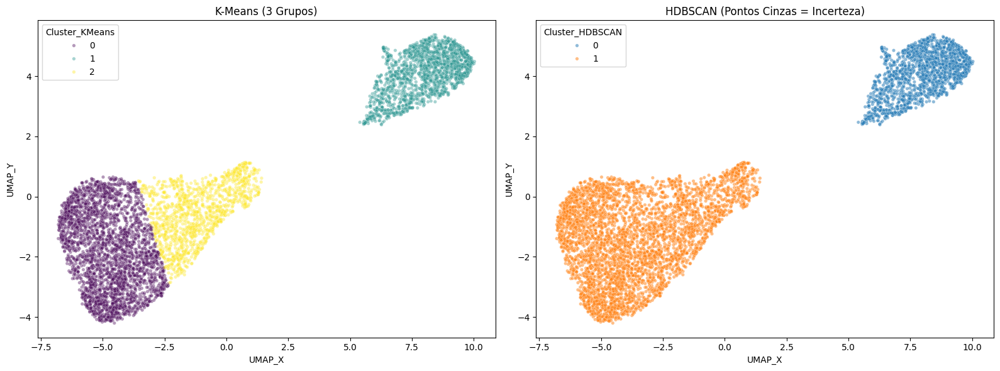

📉 Imagens de 'Incerteza' (Ruído): 0 (0.00%)


In [28]:
# --- CÉLULA 6: CLUSTERIZAÇÃO (K-MEANS e HDBSCAN) ---
from sklearn.cluster import KMeans
import hdbscan
import matplotlib.pyplot as plt
import seaborn as sns

print("🔬 [2/7] Executando Clusterização...")

# 1. K-Means (Forçando 3 grupos para comparação com Modelo A)
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
df_b['Cluster_KMeans'] = kmeans.fit_predict(embedding_2d_b)

# 2. HDBSCAN (Para detectar ruído/incerteza)
clusterer = hdbscan.HDBSCAN(min_cluster_size=60, min_samples=10)
df_b['Cluster_HDBSCAN'] = clusterer.fit_predict(embedding_2d_b)

# Salvar CSV Parcial
df_b.to_csv('resultado_modelo_B_clusters.csv', index=False)

# Visualização dos Clusters
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# K-Means
sns.scatterplot(data=df_b, x='UMAP_X', y='UMAP_Y', hue='Cluster_KMeans', 
                palette='viridis', alpha=0.4, s=15, ax=axes[0])
axes[0].set_title("K-Means (3 Grupos)")

# HDBSCAN
sns.scatterplot(data=df_b, x='UMAP_X', y='UMAP_Y', hue='Cluster_HDBSCAN', 
                palette='tab10', alpha=0.5, s=15, ax=axes[1])
axes[1].set_title("HDBSCAN (Pontos Cinzas = Incerteza)")

plt.tight_layout()
plt.show()

# Relatório de Ruído
ruidos = len(df_b[df_b['Cluster_HDBSCAN'] == -1])
print(f"📉 Imagens de 'Incerteza' (Ruído): {ruidos} ({ruidos/len(df_b)*100:.2f}%)")

🔬 [3/7] Visualizando o que o Modelo B aprendeu...


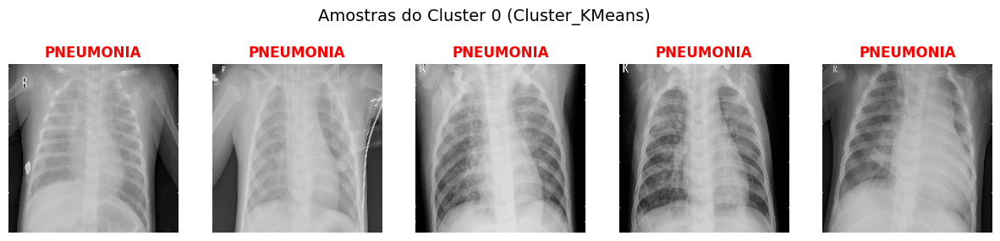

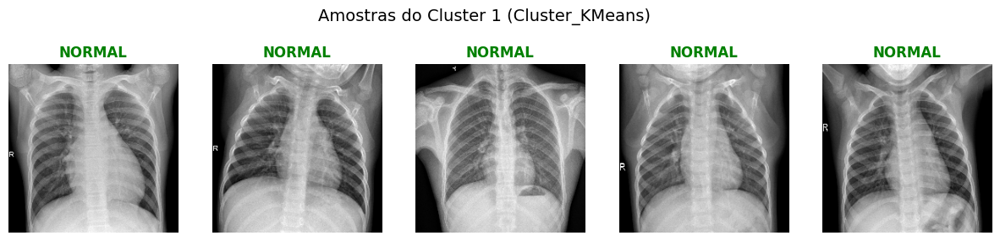

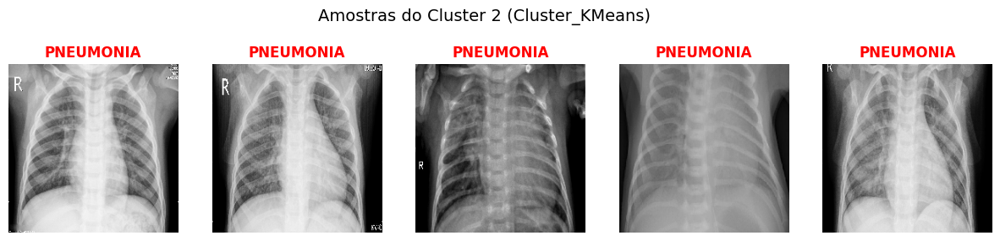

In [29]:
# --- CÉLULA 7: VISUALIZAÇÃO QUALITATIVA DAS IMAGENS ---
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
import os

def visualizar_amostras(cluster_coluna, cluster_id, num_imgs=5):
    df_subset = df_b[df_b[cluster_coluna] == cluster_id]
    if len(df_subset) == 0: return
    
    amostras = df_subset.sample(min(num_imgs, len(df_subset)), random_state=42)
    
    plt.figure(figsize=(15, 3))
    plt.suptitle(f"Amostras do Cluster {cluster_id} ({cluster_coluna})", fontsize=14, y=1.05)
    
    for i, (idx, row) in enumerate(amostras.iterrows()):
        ax = plt.subplot(1, num_imgs, i+1)
        pasta = train_dir if row['Set'] == 'train' else test_dir
        path = os.path.join(pasta, row['Filename'])
        try:
            img = image.load_img(path, target_size=(224, 224))
            plt.imshow(img, cmap='gray')
            cor = 'green' if row['Label_Nome'] == 'NORMAL' else 'red'
            plt.title(f"{row['Label_Nome']}", color=cor, fontweight='bold')
            plt.axis('off')
        except: pass
    plt.show()

print("🔬 [3/7] Visualizando o que o Modelo B aprendeu...")
# Visualiza os 3 clusters do K-Means
visualizar_amostras('Cluster_KMeans', 0)
visualizar_amostras('Cluster_KMeans', 1)
visualizar_amostras('Cluster_KMeans', 2)

🔬 [4/7] Gerando Matriz de Confusão...
20/20 ━━━━━━━━━━━━━━━━━━━━ 29s 844ms/step


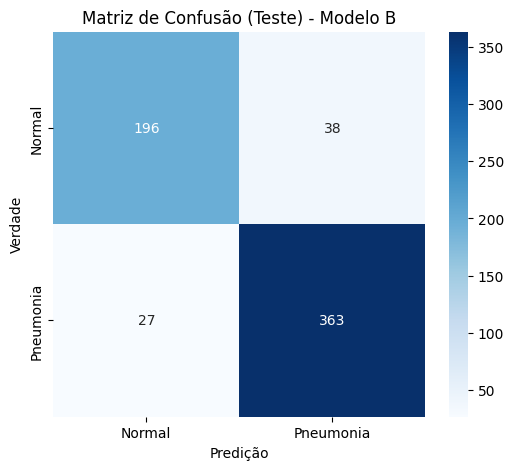

              precision    recall  f1-score   support

      Normal       0.88      0.84      0.86       234
   Pneumonia       0.91      0.93      0.92       390

    accuracy                           0.90       624
   macro avg       0.89      0.88      0.89       624
weighted avg       0.90      0.90      0.90       624



In [30]:
# --- CÉLULA 8: MATRIZ DE CONFUSÃO E RELATÓRIO ---
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

print("🔬 [4/7] Gerando Matriz de Confusão...")

# Gerar predições finais para o Teste
preds_test = model_b.predict(test_generator_no_shuffle, verbose=1)
y_pred_test_bin = (preds_test > 0.5).astype(int).reshape(-1)
y_true_test = test_generator_no_shuffle.classes

# Atualizar DataFrame com erros
df_b['Predicao'] = -1
df_b.loc[df_b['Set'] == 'test', 'Predicao'] = y_pred_test_bin
df_b['Errou'] = False
df_b.loc[df_b['Set'] == 'test', 'Errou'] = df_b.loc[df_b['Set'] == 'test', 'True_Label'] != df_b.loc[df_b['Set'] == 'test', 'Predicao']

# Plotar
plt.figure(figsize=(6, 5))
cm = confusion_matrix(y_true_test, y_pred_test_bin)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Normal', 'Pneumonia'], yticklabels=['Normal', 'Pneumonia'])
plt.title('Matriz de Confusão (Teste) - Modelo B')
plt.ylabel('Verdade')
plt.xlabel('Predição')
plt.show()

print(classification_report(y_true_test, y_pred_test_bin, target_names=['Normal', 'Pneumonia']))

🔬 [5/7] Mapeando Erros no Espaço Latente...


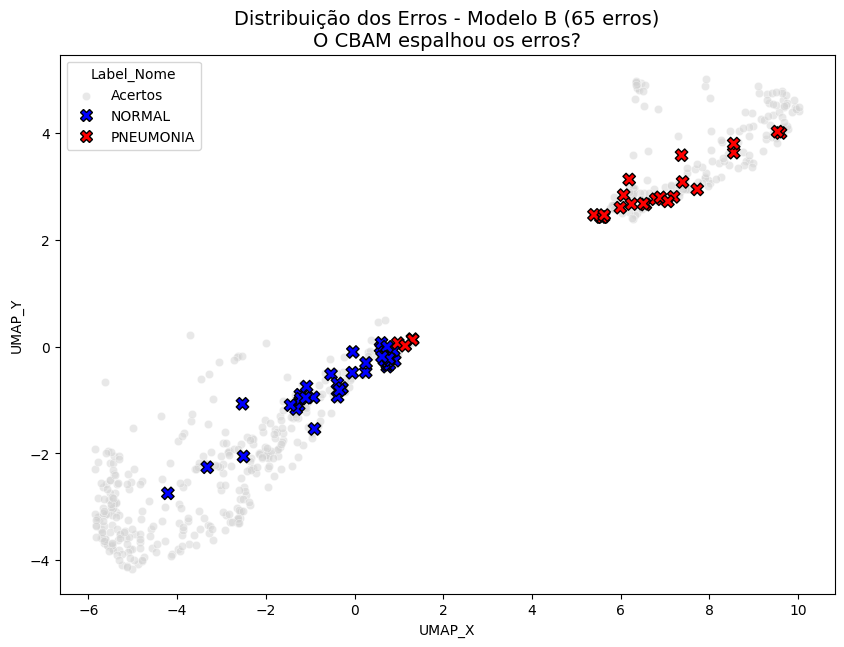

In [31]:
# --- CÉLULA 9: PROJETANDO OS ERROS NO UMAP ---

print("🔬 [5/7] Mapeando Erros no Espaço Latente...")

plt.figure(figsize=(10, 7))

# Fundo (Acertos)
sns.scatterplot(
    data=df_b[df_b['Set'] == 'test'], 
    x='UMAP_X', y='UMAP_Y', 
    color='lightgray', alpha=0.5, label='Acertos'
)

# Erros (X)
erros_df = df_b[(df_b['Set'] == 'test') & (df_b['Errou'] == True)]

sns.scatterplot(
    data=erros_df,
    x='UMAP_X', y='UMAP_Y',
    hue='Label_Nome', 
    palette={'NORMAL': 'blue', 'PNEUMONIA': 'red'},
    s=80, marker='X', edgecolor='black', linewidth=1
)

plt.title(f"Distribuição dos Erros - Modelo B ({len(erros_df)} erros)\nO CBAM espalhou os erros?", fontsize=14)
plt.show()

🔬 [6/7] Teste de Viés de Luminosidade...
Cluster 0: Brilho Médio = 121.32
Cluster 1: Brilho Médio = 123.66
Cluster 2: Brilho Médio = 128.32


/tmp/ipykernel_268/1117719380.py:29: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_brilho_viz, x='Cluster', y='Brilho_Medio', palette='viridis')


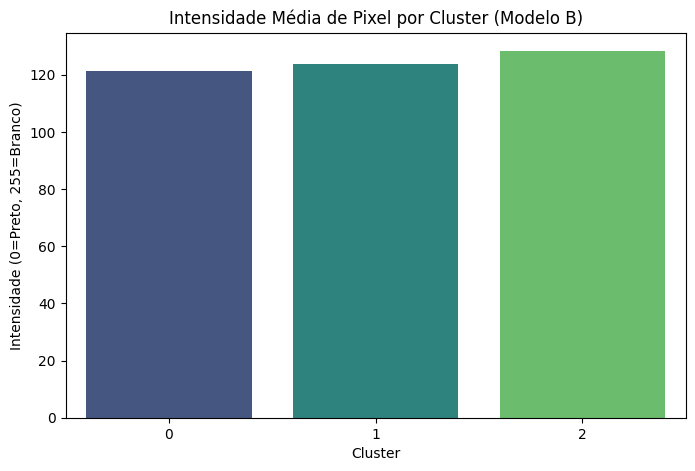

In [32]:
# --- CÉLULA 10: QUANTIFICANDO O BRILHO DOS CLUSTERS ---
import numpy as np

print("🔬 [6/7] Teste de Viés de Luminosidade...")
resultados_brilho = []

for cluster_id in sorted(df_b['Cluster_KMeans'].unique()):
    # Amostra de 50 imagens por cluster para ser rápido
    df_subset = df_b[df_b['Cluster_KMeans'] == cluster_id]
    amostra = df_subset.sample(min(50, len(df_subset)), random_state=42)
    
    brilhos = []
    for _, row in amostra.iterrows():
        pasta = train_dir if row['Set'] == 'train' else test_dir
        path = os.path.join(pasta, row['Filename'])
        try:
            # Carrega em escala de cinza e tira a média
            img = image.load_img(path, color_mode='grayscale', target_size=(224, 224))
            brilhos.append(np.mean(image.img_to_array(img)))
        except: pass
            
    media_cluster = np.mean(brilhos)
    resultados_brilho.append({'Cluster': cluster_id, 'Brilho_Medio': media_cluster})
    print(f"Cluster {cluster_id}: Brilho Médio = {media_cluster:.2f}")

# Gráfico
df_brilho_viz = pd.DataFrame(resultados_brilho)
plt.figure(figsize=(8, 5))
sns.barplot(data=df_brilho_viz, x='Cluster', y='Brilho_Medio', palette='viridis')
plt.title("Intensidade Média de Pixel por Cluster (Modelo B)")
plt.ylabel("Intensidade (0=Preto, 255=Branco)")
plt.show()

🔬 [7/7] Gerando Dendrograma...


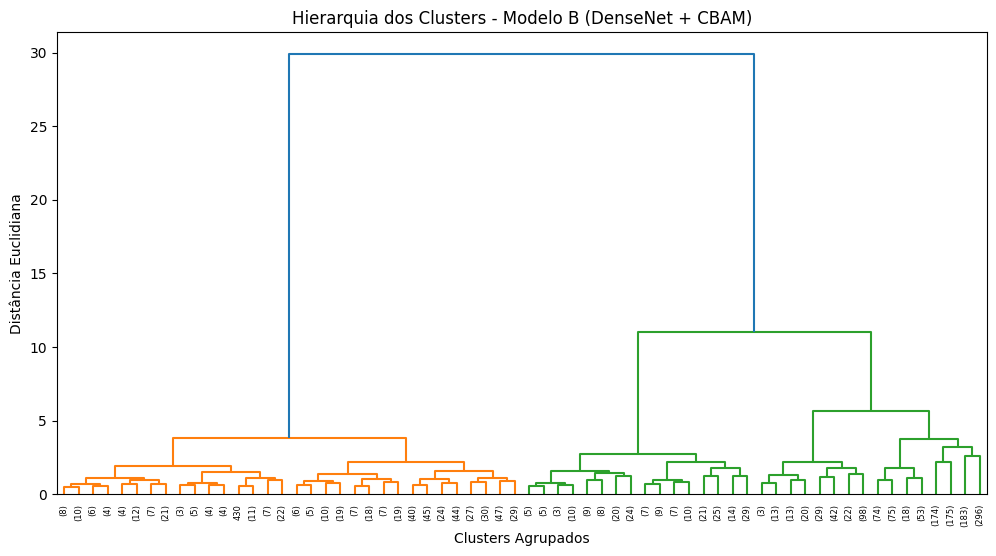

✅ Todas as análises concluídas!


In [33]:
# --- CÉLULA 11: DENDROGRAMA HIERÁRQUICO ---
from scipy.cluster.hierarchy import dendrogram, linkage

print("🔬 [7/7] Gerando Dendrograma...")

plt.figure(figsize=(12, 6))

# Amostra aleatória de 2000 pontos (para o gráfico não travar)
idx_sample = np.random.choice(len(X_norm_b), 2000, replace=False)

# Linkage Ward (Minimiza a variância dos clusters)
linkage_matrix = linkage(X_norm_b[idx_sample], method='ward')

dendrogram(linkage_matrix, truncate_mode='level', p=5)
plt.title("Hierarquia dos Clusters - Modelo B (DenseNet + CBAM)")
plt.xlabel("Clusters Agrupados")
plt.ylabel("Distância Euclidiana")
plt.show()

print("✅ Todas as análises concluídas!")

🔍 Re-executando HDBSCAN com parâmetros mais sensíveis...
📉 Novo Ruído: 0 (0.00%)
🌈 Quantidade de Micro-Clusters encontrados: 1


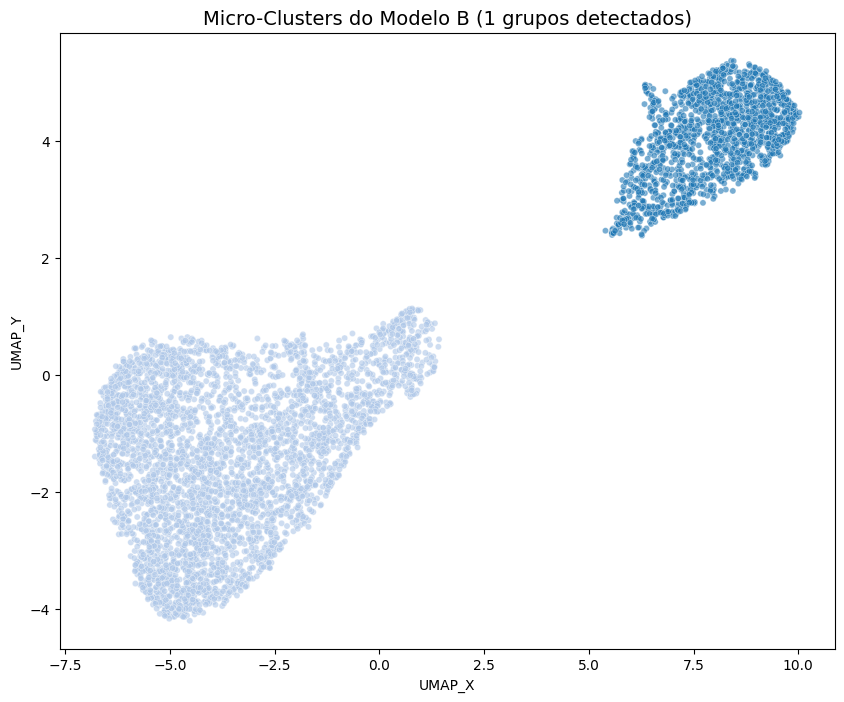

In [34]:
# --- RE-ANÁLISE DE CLUSTERS (Ajuste Fino) ---
# Vamos tentar encontrar os "Micro-Clusters" escondidos no ruído

print("🔍 Re-executando HDBSCAN com parâmetros mais sensíveis...")

# Reduzimos min_cluster_size de 60 para 20
# Isso vai permitir que o algoritmo encontre grupos pequenos (ex: um tipo raro de pneumonia viral)
clusterer_fino = hdbscan.HDBSCAN(min_cluster_size=20, min_samples=5)
labels_fino = clusterer_fino.fit_predict(embedding_2d_b)

# Atualiza DataFrame
df_b['Cluster_Fino'] = labels_fino
ruidos_fino = len(df_b[df_b['Cluster_Fino'] == -1])
num_clusters = len(df_b['Cluster_Fino'].unique()) - 1 # Tira o -1 da conta

print(f"📉 Novo Ruído: {ruidos_fino} ({ruidos_fino/len(df_b)*100:.2f}%)")
print(f"🌈 Quantidade de Micro-Clusters encontrados: {num_clusters}")

# Visualizar
plt.figure(figsize=(10, 8))
sns.scatterplot(
    data=df_b, x='UMAP_X', y='UMAP_Y', 
    hue='Cluster_Fino', 
    palette='tab20', # Paleta com mais cores
    s=20, alpha=0.6, legend=False
)
plt.title(f"Micro-Clusters do Modelo B ({num_clusters} grupos detectados)", fontsize=14)
plt.show()

In [35]:
# --- SALVAR O CÉREBRO DO MODELO B (Corrigido) ---
import pandas as pd

# 1. Salvar o Modelo Treinado (model_b)
nome_modelo_b = 'modelo_B_cbam_final.keras'
# Verifica se o modelo existe antes de tentar salvar
if 'model_b' in locals():
    model_b.save(nome_modelo_b)
    print(f"✅ Modelo B salvo em: {nome_modelo_b}")
else:
    print("❌ Erro: 'model_b' não encontrado na memória.")

# 2. Salvar os Dados da Análise (df_b)
nome_csv_b = 'resultado_modelo_B_cbam.csv'

if 'df_b' in locals():
    df_b.to_csv(nome_csv_b, index=False)
    print(f"✅ Arquivo '{nome_csv_b}' salvo com sucesso!")
else:
    print("❌ Erro: DataFrame 'df_b' não encontrado. Rode a célula de Análise/UMAP primeiro.")

print("\n⚠️ IMPORTANTE: Vá na aba lateral direita 'Output' do Kaggle e baixe esses arquivos.")

✅ Modelo B salvo em: modelo_B_cbam_final.keras
✅ Arquivo 'resultado_modelo_B_cbam.csv' salvo com sucesso!

⚠️ IMPORTANTE: Vá na aba lateral direita 'Output' do Kaggle e baixe esses arquivos.


🕵️ Iniciando Análise Forense dos Erros (FP + FN)...
Total de Erros para analisar: 65
Tipo_Erro
FP (Alarme Falso)    38
FN (Perigoso)        27
Name: count, dtype: int64


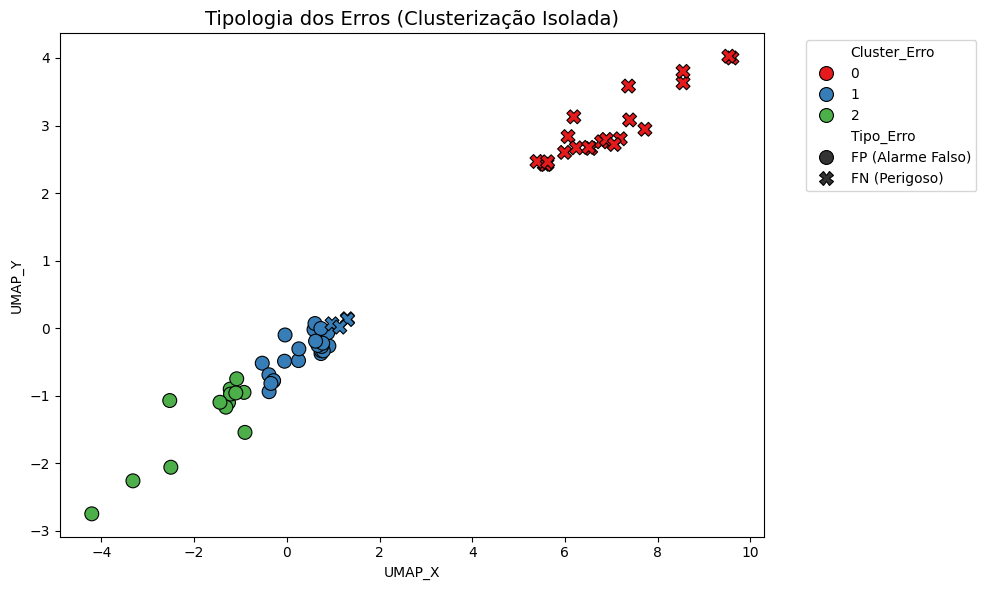

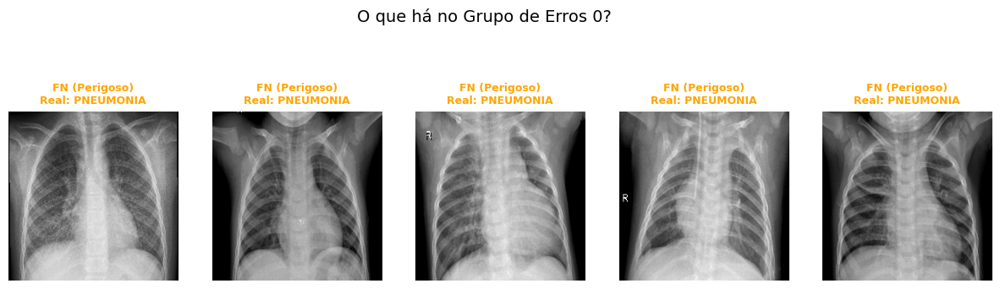

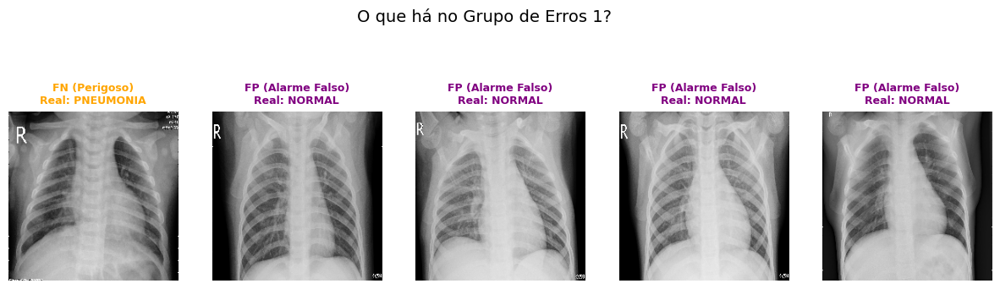

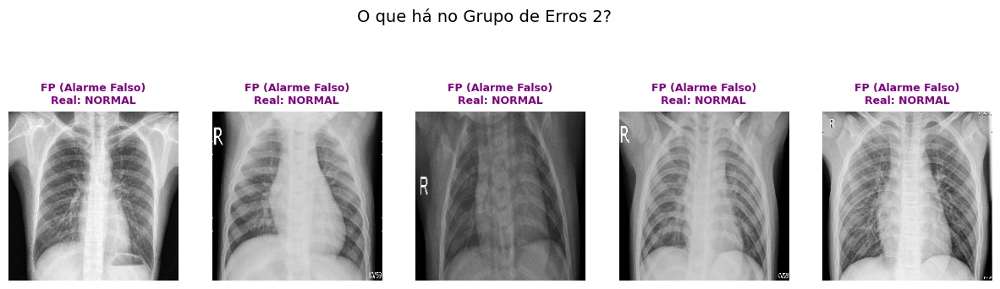

In [36]:
# --- CÉLULA 6: CLUSTERIZAÇÃO ESPECÍFICA DE ERROS (O OBJETIVO ORIGINAL) ---
# Aqui focamos 100% em entender a tipologia dos erros (FP e FN)

print("🕵️ Iniciando Análise Forense dos Erros (FP + FN)...")

# 1. Isolar apenas os erros do DataFrame do Modelo B
df_erros = df_b[df_b['Errou'] == True].copy()

# Definir quem é FP e quem é FN
# FN (Falso Negativo): Era Pneumonia (1), Modelo disse Normal (0)
# FP (Falso Positivo): Era Normal (0), Modelo disse Pneumonia (1)
df_erros['Tipo_Erro'] = df_erros.apply(lambda x: 'FN (Perigoso)' if x['True_Label'] == 1 else 'FP (Alarme Falso)', axis=1)

print(f"Total de Erros para analisar: {len(df_erros)}")
print(df_erros['Tipo_Erro'].value_counts())

if len(df_erros) > 5:
    # 2. Clusterizar APENAS os erros (K-Means interno)
    # Usamos as coordenadas do UMAP que já calculamos, mas o K-Means agora só olha para os erros
    kmeans_erros = KMeans(n_clusters=3, random_state=42, n_init=10)
    df_erros['Cluster_Erro'] = kmeans_erros.fit_predict(df_erros[['UMAP_X', 'UMAP_Y']])

    # 3. Visualizar a "Galeria dos Erros"
    plt.figure(figsize=(10, 6))
    sns.scatterplot(
        data=df_erros, x='UMAP_X', y='UMAP_Y', 
        hue='Cluster_Erro', style='Tipo_Erro',
        palette='Set1', s=100, edgecolor='black'
    )
    plt.title("Tipologia dos Erros (Clusterização Isolada)", fontsize=14)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
    plt.tight_layout()
    plt.show()

    # 4. Mostrar as imagens típicas de cada grupo de erro
    def ver_erros_cluster(cluster_id):
        subset = df_erros[df_erros['Cluster_Erro'] == cluster_id]
        if len(subset) == 0: return
        
        # Pega as 5 amostras mais representativas (aleatórias)
        amostras = subset.sample(min(5, len(subset)), random_state=42)
        
        plt.figure(figsize=(15, 4))
        plt.suptitle(f"O que há no Grupo de Erros {cluster_id}?", fontsize=14, y=1.05)
        
        for i, (idx, row) in enumerate(amostras.iterrows()):
            ax = plt.subplot(1, 5, i+1)
            pasta = train_dir if row['Set'] == 'train' else test_dir
            path = os.path.join(pasta, row['Filename'])
            try:
                img = image.load_img(path, target_size=(224, 224))
                plt.imshow(img, cmap='gray')
                
                # Título explica o erro
                cor = 'orange' if 'FN' in row['Tipo_Erro'] else 'purple'
                plt.title(f"{row['Tipo_Erro']}\nReal: {row['Label_Nome']}", color=cor, fontweight='bold', fontsize=9)
                plt.axis('off')
            except: pass
        plt.show()

    # Executa a visualização
    for c in sorted(df_erros['Cluster_Erro'].unique()):
        ver_erros_cluster(c)

else:
    print("Poucos erros para clusterizar! O modelo foi muito bem.")

🔍 Executando HDBSCAN Fino e Mapeando os 68 Erros...


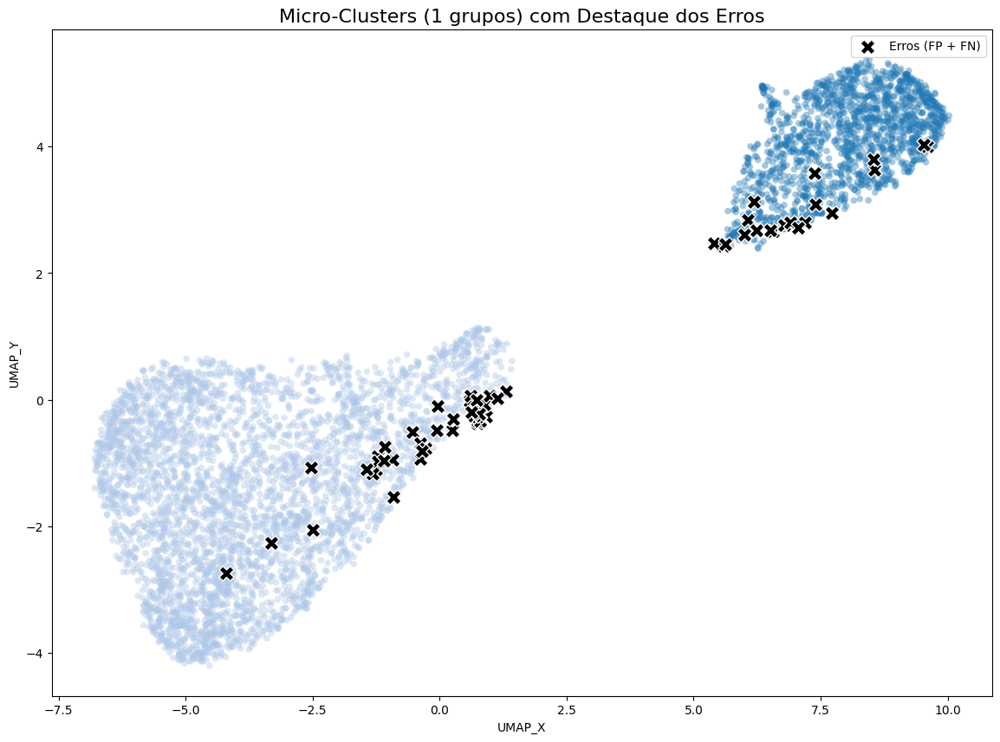

📉 Total de Erros destacados no mapa: 65
Análise: Se os 'X' pretos caírem todos na mesma cor, achamos um padrão de erro específico!


In [37]:
# --- RE-ANÁLISE DE CLUSTERS (Ajuste Fino com Destaque de Erros) ---
from sklearn.metrics import confusion_matrix

print("🔍 Executando HDBSCAN Fino e Mapeando os 68 Erros...")

# 1. Recalcular Predições (Caso ainda não tenha feito) para achar os erros
# Precisamos saber quem é FP e FN
preds = model_b.predict(test_generator_no_shuffle, verbose=0)
y_pred_bin = (preds > 0.5).astype(int).reshape(-1)

# Adiciona info de erro ao DataFrame (apenas nas linhas de teste)
df_b['Predicao'] = -1
df_b.loc[df_b['Set'] == 'test', 'Predicao'] = y_pred_bin
df_b['Errou'] = False
mask_erro = (df_b['Set'] == 'test') & (df_b['True_Label'] != df_b['Predicao'])
df_b.loc[mask_erro, 'Errou'] = True

# 2. Rodar o HDBSCAN Fino (Micro-Clusters)
clusterer_fino = hdbscan.HDBSCAN(min_cluster_size=20, min_samples=5)
df_b['Cluster_Fino'] = clusterer_fino.fit_predict(embedding_2d_b)

num_clusters = len(df_b['Cluster_Fino'].unique()) - 1
ruidos_fino = len(df_b[df_b['Cluster_Fino'] == -1])

# 3. VISUALIZAÇÃO COM SOBREPOSIÇÃO
plt.figure(figsize=(14, 10))

# CAMADA 1: O Mapa Geral (Micro-Clusters)
# Plotamos todos os pontos com transparência para ver o fundo
sns.scatterplot(
    data=df_b, x='UMAP_X', y='UMAP_Y', 
    hue='Cluster_Fino', 
    palette='tab20', # Muitas cores para os micro-grupos
    s=30, alpha=0.4, linewidth=0, legend=False
)

# CAMADA 2: Apenas os Erros (Os ~68 pontos)
# Filtramos apenas quem errou
df_erros = df_b[df_b['Errou'] == True]

sns.scatterplot(
    data=df_erros, x='UMAP_X', y='UMAP_Y', 
    color='black', # Cor de destaque
    marker='X',    # Formato de X
    s=150,         # Tamanho grande
    label='Erros (FP + FN)'
)

plt.title(f"Micro-Clusters ({num_clusters} grupos) com Destaque dos Erros", fontsize=16)
plt.legend(loc='upper right')
plt.show()

print(f"📉 Total de Erros destacados no mapa: {len(df_erros)}")
print("Análise: Se os 'X' pretos caírem todos na mesma cor, achamos um padrão de erro específico!")

🔬 [2/7] Executando Clusterização com Overlay de Erros...


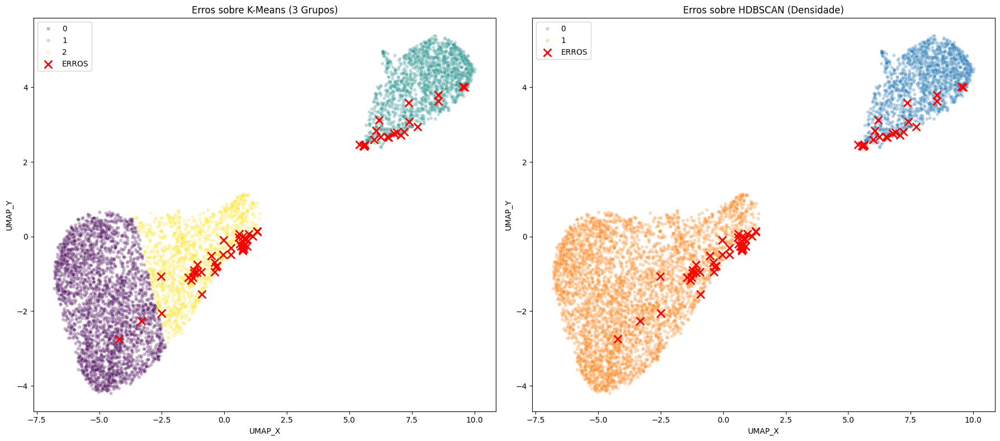

In [38]:
# --- CÉLULA 6 (MODIFICADA): CLUSTERIZAÇÃO COM DESTAQUE DE ERROS ---
from sklearn.cluster import KMeans
import hdbscan
import matplotlib.pyplot as plt
import seaborn as sns

print("🔬 [2/7] Executando Clusterização com Overlay de Erros...")

# 1. K-Means e HDBSCAN Padrão
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
df_b['Cluster_KMeans'] = kmeans.fit_predict(embedding_2d_b)

clusterer = hdbscan.HDBSCAN(min_cluster_size=60, min_samples=10)
df_b['Cluster_HDBSCAN'] = clusterer.fit_predict(embedding_2d_b)

# 2. Garantir que temos os erros identificados
if 'Errou' not in df_b.columns:
    # Calcula rapidinho se não existir
    preds = model_b.predict(test_generator_no_shuffle, verbose=0)
    y_pred = (preds > 0.5).astype(int).reshape(-1)
    df_b.loc[df_b['Set'] == 'test', 'Predicao'] = y_pred
    df_b['Errou'] = (df_b['Set'] == 'test') & (df_b['True_Label'] != df_b['Predicao'])

df_erros = df_b[df_b['Errou'] == True]

# 3. Visualização Comparativa com Erros
fig, axes = plt.subplots(1, 2, figsize=(18, 8))

# Gráfico da Esquerda: K-Means + Erros
sns.scatterplot(data=df_b, x='UMAP_X', y='UMAP_Y', hue='Cluster_KMeans', 
                palette='viridis', alpha=0.3, s=20, ax=axes[0])
# Desenha os erros por cima
axes[0].scatter(df_erros['UMAP_X'], df_erros['UMAP_Y'], c='red', marker='x', s=100, linewidth=2, label='ERROS')
axes[0].set_title(f"Erros sobre K-Means (3 Grupos)")
axes[0].legend()

# Gráfico da Direita: HDBSCAN + Erros
sns.scatterplot(data=df_b, x='UMAP_X', y='UMAP_Y', hue='Cluster_HDBSCAN', 
                palette='tab10', alpha=0.3, s=20, ax=axes[1])
# Desenha os erros por cima
axes[1].scatter(df_erros['UMAP_X'], df_erros['UMAP_Y'], c='red', marker='x', s=100, linewidth=2, label='ERROS')
axes[1].set_title(f"Erros sobre HDBSCAN (Densidade)")
axes[1].legend()

plt.tight_layout()
plt.show()

🕵️ Iniciando Geração da Galeria de Erros...
   -> Agrupando erros por similaridade visual...


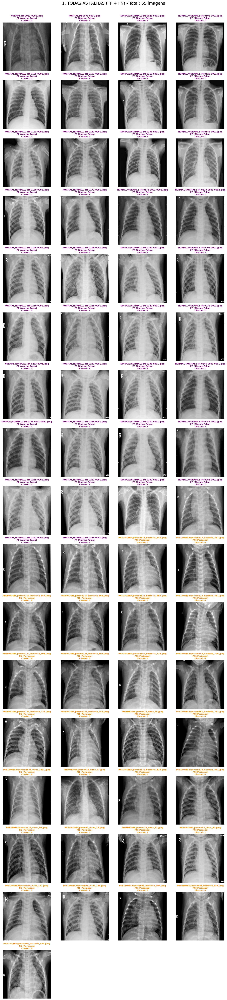

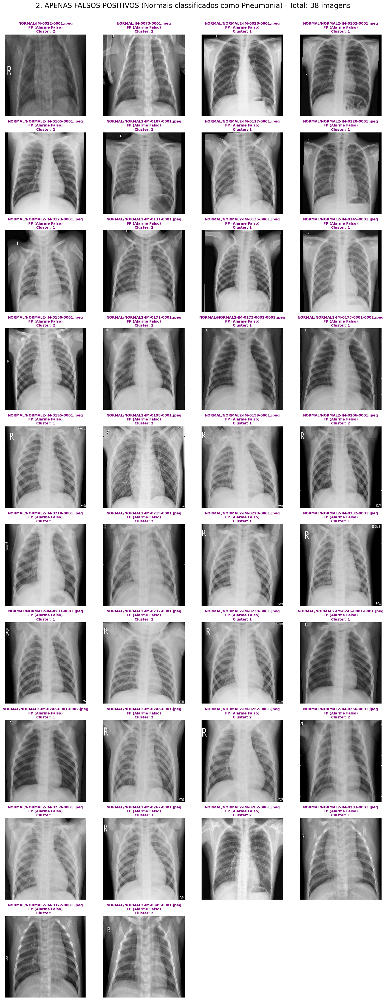

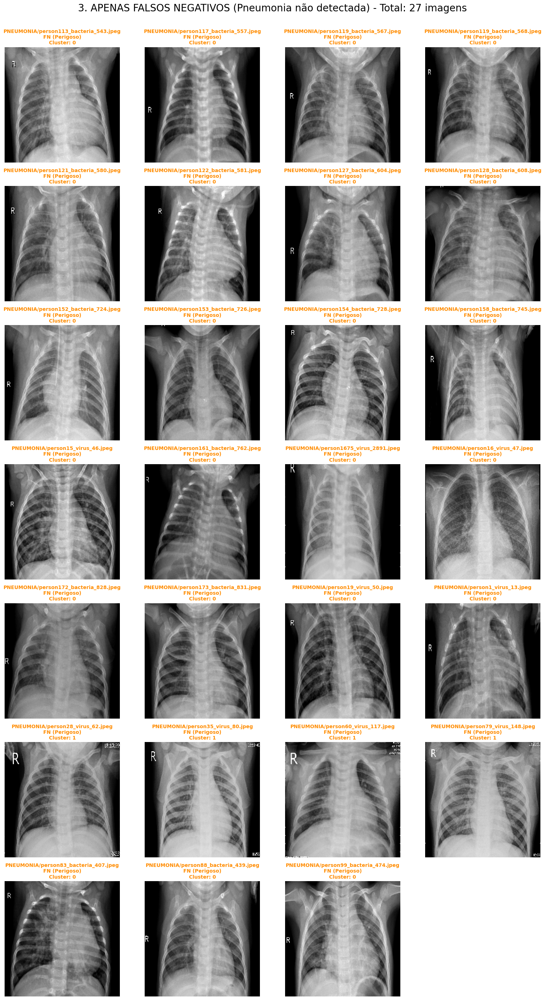


--- ANÁLISE DOS GRUPOS DE ERRO ---
O K-Means separou os erros em 3 'tipos' visuais. Vamos ver o que é cada um:


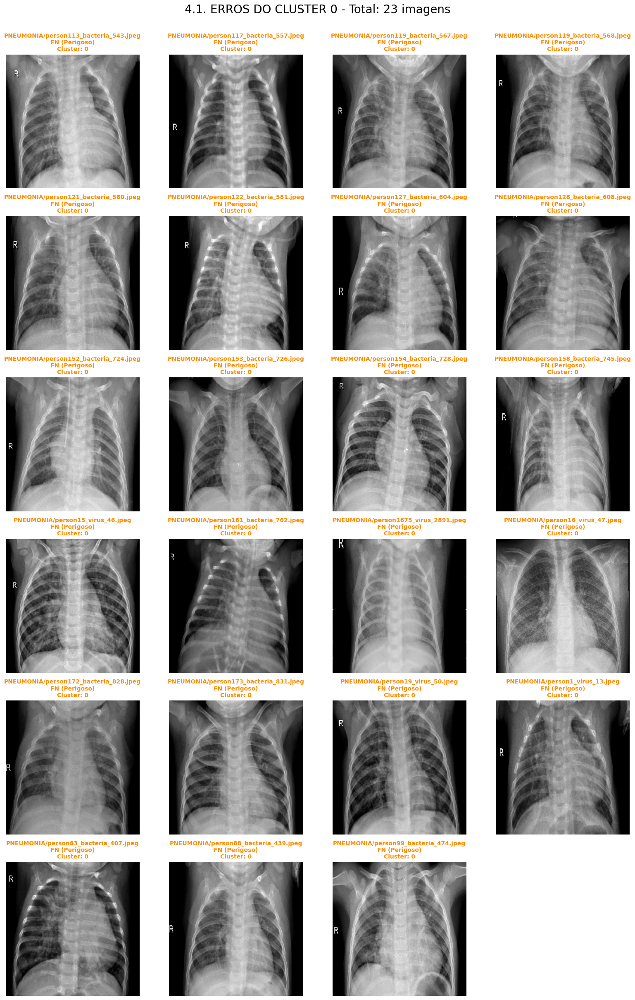

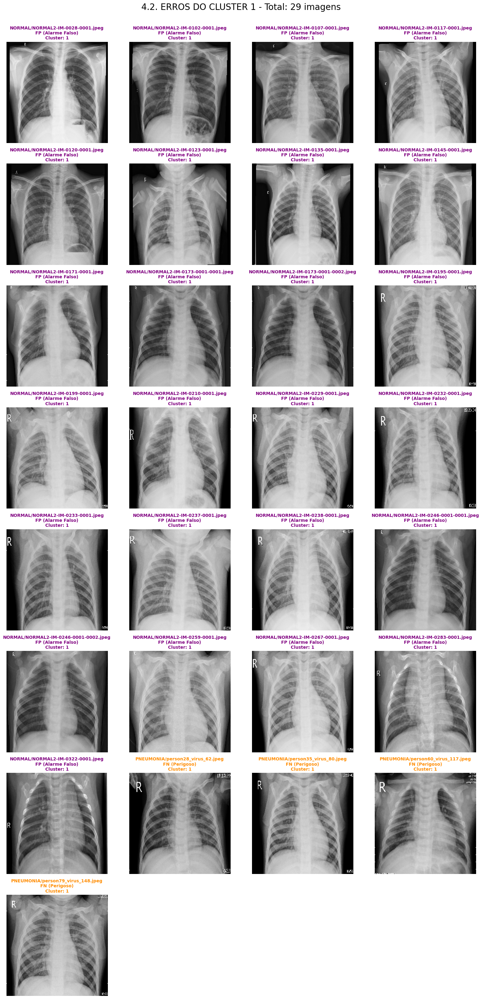

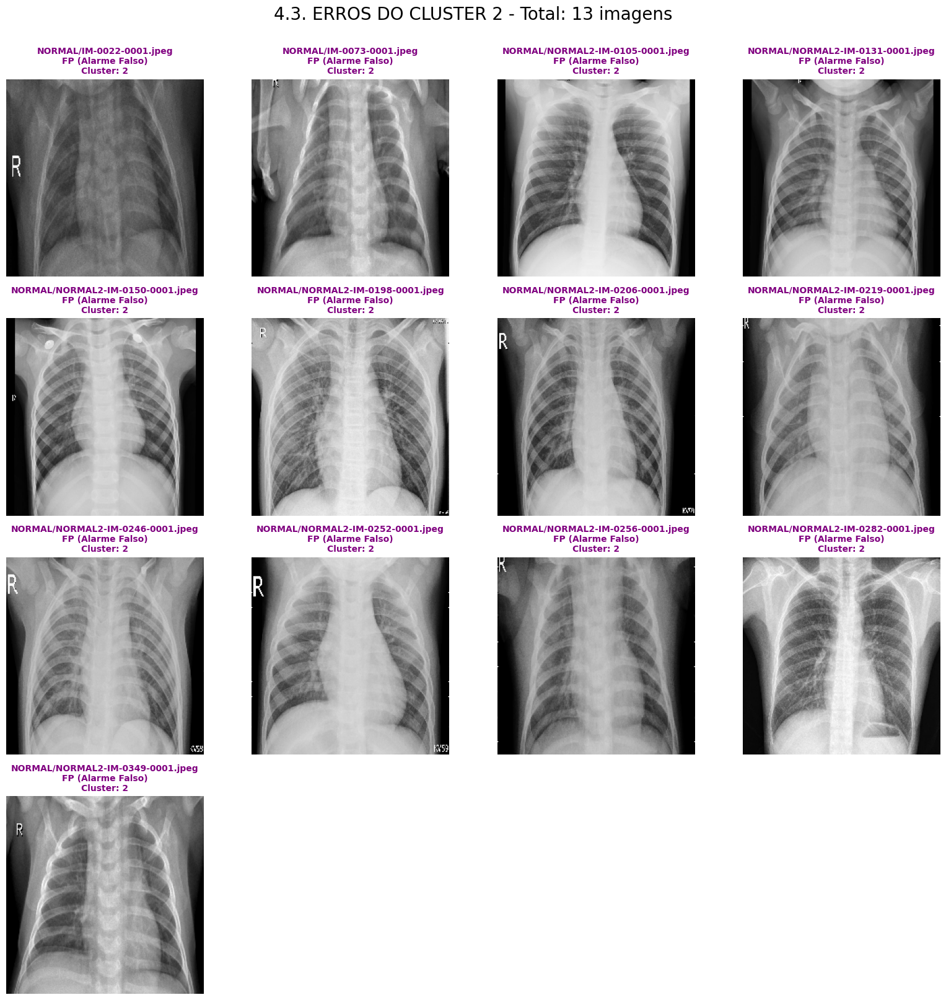

In [39]:
# --- CÉLULA: CATÁLOGO FORENSE DE ERROS (VISUALIZAÇÃO TOTAL) ---
import math
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image
from sklearn.cluster import KMeans

print("🕵️ Iniciando Geração da Galeria de Erros...")

# 1. Preparar os Dados dos Erros
# Filtra onde o modelo errou
df_erros = df_b[df_b['Errou'] == True].copy()

# Define o tipo de erro (Texto para o título)
# FP = Alarme Falso (Disse que tinha pneumonia, mas não tinha)
# FN = Perigoso (Tinha pneumonia, mas disse que era normal)
df_erros['Tipo_Erro'] = df_erros.apply(lambda x: 'FN (Perigoso)' if x['True_Label'] == 1 else 'FP (Alarme Falso)', axis=1)

# 2. Clusterizar os Erros (Para separar em grupos 0, 1 e 2 como pediu)
# Usamos K-Means apenas nestes 68 erros
print("   -> Agrupando erros por similaridade visual...")
kmeans_erros = KMeans(n_clusters=3, random_state=42, n_init=10)
df_erros['Cluster_Erro'] = kmeans_erros.fit_predict(df_erros[['UMAP_X', 'UMAP_Y']])

# --- FUNÇÃO DE PLOTAGEM (Imprime todas as imagens de uma lista) ---
def galeria_de_erros(df_alvo, titulo_geral):
    total_imgs = len(df_alvo)
    if total_imgs == 0:
        print(f"⚠️ Nenhuma imagem encontrada para: {titulo_geral}")
        return

    # Configura grade (4 colunas)
    cols = 4
    rows = math.ceil(total_imgs / cols)
    
    plt.figure(figsize=(16, 4 * rows))
    plt.suptitle(f"{titulo_geral} - Total: {total_imgs} imagens", fontsize=20, y=1.005)
    
    for i, (idx, row) in enumerate(df_alvo.iterrows()):
        ax = plt.subplot(rows, cols, i+1)
        
        # Carrega imagem
        pasta = train_dir if row['Set'] == 'train' else test_dir
        path = os.path.join(pasta, row['Filename'])
        
        try:
            img = image.load_img(path, target_size=(224, 224))
            plt.imshow(img, cmap='gray')
            
            # Cor do título: Roxo para FP, Laranja para FN
            cor = 'purple' if 'FP' in row['Tipo_Erro'] else 'darkorange'
            
            plt.title(f"{row['Filename']}\n{row['Tipo_Erro']}\nCluster: {row['Cluster_Erro']}", 
                      color=cor, fontweight='bold', fontsize=10)
            plt.axis('off')
        except Exception as e:
            plt.text(0.5, 0.5, "Erro ao carregar", ha='center')
            plt.axis('off')
            
    plt.tight_layout()
    plt.show()

# --- EXECUTANDO AS SOLICITAÇÕES ---

# 1. TODOS OS ERROS (Os ~68 juntos)
galeria_de_erros(df_erros, "1. TODAS AS FALHAS (FP + FN)")

# 2. APENAS FALSOS POSITIVOS (Alarmes Falsos)
df_fp = df_erros[df_erros['Tipo_Erro'].str.contains('FP')]
galeria_de_erros(df_fp, "2. APENAS FALSOS POSITIVOS (Normais classificados como Pneumonia)")

# 3. APENAS FALSOS NEGATIVOS (Perigosos)
df_fn = df_erros[df_erros['Tipo_Erro'].str.contains('FN')]
galeria_de_erros(df_fn, "3. APENAS FALSOS NEGATIVOS (Pneumonia não detectada)")

# 4. POR CLUSTER DE ERRO (Análise Tipológica)
print("\n--- ANÁLISE DOS GRUPOS DE ERRO ---")
print("O K-Means separou os erros em 3 'tipos' visuais. Vamos ver o que é cada um:")

df_c0 = df_erros[df_erros['Cluster_Erro'] == 0]
galeria_de_erros(df_c0, "4.1. ERROS DO CLUSTER 0")

df_c1 = df_erros[df_erros['Cluster_Erro'] == 1]
galeria_de_erros(df_c1, "4.2. ERROS DO CLUSTER 1")

df_c2 = df_erros[df_erros['Cluster_Erro'] == 2]
galeria_de_erros(df_c2, "4.3. ERROS DO CLUSTER 2")